In [78]:
import cv2
import json
import glob
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Polygon
from matplotlib.patches import Polygon as Poly

In [ ]:
# %matplotlib notebook

In [79]:
dir_location = '/scratch/ichakr2s/bdd100k/data/labels/10k/ins_seg/polygons/'
train_location = '/scratch/ichakr2s/bdd100k/data/images/10k/train/'

In [84]:
# with open('sample.json', 'r') as f:
#   data = json.load(f)

with open(dir_location + 'ins_seg_train.json', 'r') as f:
    bdd_data = json.load(f)
bdd_data

[{'name': '6b73ccdd-00000000.jpg',
  'labels': [{'id': 8,
    'category': 'car',
    'attributes': {},
    'poly2d': [{'vertices': [[447.10194027741323, 413.3721908242511],
       [447.7259420100988, 411.31373229785294],
       [448.8461378916668, 409.48683156039937],
       [450.46252792211726, 407.8914886118906],
       [452.57511210145015, 406.52770345232653],
       [455.18389042966567, 405.3954760817072],
       [458.28886290676354, 404.4948065000326],
       [461.89002953274394, 403.8256947073027],
       [465.9873903076068, 403.38814070351754],
       [470.5809452313521, 403.1821444886771],
       [470.8440784921231, 401.8108412190824],
       [471.1523203118835, 400.5237407818313],
       [471.505670690633, 399.3208431769236],
       [471.904129628372, 398.2021484043595],
       [472.3476971251003, 397.1676564641389],
       [472.8363731808179, 396.21736735626183],
       [473.37015779552473, 395.3512810807283],
       [473.949050969221, 394.5693976375384],
       [474.57305270

In [89]:
bdd_data[0]['labels'][0]['category']

'car'

In [83]:
bdd10k_category_list = []
for img in bdd_data:
    for properties in img['labels']:
        if properties['category'] not in bdd10k_category_list:
            bdd10k_category_list.append(properties['category'])
bdd10k_category_list

['car',
 'person',
 'truck',
 'bus',
 'bicycle',
 'rider',
 'trailer',
 'motorcycle',
 'caravan',
 'train']

In [86]:
instance_count = []
for cat in bdd10k_category_list:
    cat_count = 0
    for idx in range(len(bdd_data)):
        for lab in bdd_data[idx]['labels']:
            if bdd_data[idx]['labels'][lab]['category'] == cat:
                cat_count += 1
    instance_count.append([{cat: cat_count}])
instance_count           

TypeError: list indices must be integers or slices, not dict

In [ ]:
file_names = []
for idx in range(len(bdd_data)):
    for lab in bdd_data[idx]['labels']:
        if lab['category'] == 'person':
            file_names.append(bdd_data[idx]['name'])
            break

In [ ]:
plt.figure(figsize=(20, 20))
ax = plt.subplot()
ax.clear()
img1 = bdd_data[6583]
im1 = cv2.imread(train_location + img1['name'])
plt.imshow(im1)
for idx, an in enumerate(img1['labels']):
    if an['category'] == 'person':
        seg = np.array(an['poly2d'][0]['vertices'])
        segment = Polygon(seg)
        f = Poly(np.array(segment.exterior.xy).T, edgecolor = 'g', facecolor = 'g', alpha=0.6)
        ax.add_patch(f)
plt.show()

plt.figure(figsize=(20, 20))
ax = plt.subplot()
ax.clear()
img2 = bdd_data[603]
im2 = cv2.imread(train_location + img2['name'])
plt.imshow(im2)
for an in img2['labels']:
    if an['category'] != 'car':
        seg = np.array(an['poly2d'][0]['vertices'])
        segment = Polygon(seg)
        f = Poly(np.array(segment.exterior.xy).T, edgecolor = 'g', facecolor = 'g', alpha=0.6)
        ax.add_patch(f)
plt.show()

In [ ]:
scale_factor = 0.001
area_thresh = im1.shape[0] *  im1.shape[1] * scale_factor


f_high = 1.55
f_low = 0.45

idx_1_2 = []
for idx1, annot1 in enumerate(bdd_data[6583]['labels']):
    if annot1['category'] == 'person':
        shape1 = np.array(annot1['poly2d'][0]['vertices'])
        seg1 = Polygon(shape1)
        ann1_ratio = (np.max(shape1[:,1])-np.min(shape1[:,1]))/(np.max(shape1[:,0])-np.min(shape1[:,0]))
        area1 = seg1.area
        if area1 > area_thresh:
            for idx2, annot2 in enumerate(bdd_data[603]['labels']):
                if annot2['category'] == 'person':
                    shape2 = np.array(annot2['poly2d'][0]['vertices'])
                    seg2 = Polygon(shape2)
                    ann2_ratio = (np.max(shape2[:,1])-np.min(shape2[:,1]))/(np.max(shape2[:,0])-np.min(shape2[:,0]))
                    area2 = seg2.area
                    if area2 > area_thresh:
                        f = area1/area2
                        if abs(ann2_ratio-ann1_ratio) < 1.:
                            if f < f_high and f > f_low:
                                idx_1_2.append([idx1, idx2])

idx_1_2 = np.array(idx_1_2)
print('Swappable indices: ', idx_1_2)

In [ ]:
plt.figure(figsize=(20, 20))
ax = plt.subplot()
ax.clear()
img1 = bdd_data[6583]
im1 = cv2.imread(train_location + img1['name'])
plt.imshow(im1)
for idx, an in enumerate(img1['labels']):
    if idx in list(idx_1_2[:,0]):
        seg = np.array(an['poly2d'][0]['vertices'])
        segment = Polygon(seg)
        f = Poly(np.array(segment.exterior.xy).T, edgecolor = 'g', facecolor = 'g', alpha=0.6)
        ax.add_patch(f)
plt.show()

plt.figure(figsize=(20, 20))
ax = plt.subplot()
ax.clear()
img2 = bdd_data[603]
im2 = cv2.imread(train_location + img2['name'])
plt.imshow(im2)
for idx, an in enumerate(img2['labels']):
    if idx in list(idx_1_2[:,1]):
        seg = np.array(an['poly2d'][0]['vertices'])
        segment = Polygon(seg)
        f = Poly(np.array(segment.exterior.xy).T, edgecolor = 'g', facecolor = 'g', alpha=0.6)
        ax.add_patch(f)
plt.show()

In [ ]:
def swap(i1, i2, idx_1_2, swap_idx):
    
    image1 = cv2.imread(train_location + i1['name'])
    annot1 = i1['labels'][idx_1_2[swap_idx][0]]
    roi_corners1 = np.array([annot1['poly2d'][0]['vertices']], dtype=np.int32)
    roi_mean1 = np.mean(roi_corners1[0], axis=0)
    roi_norm1 = roi_corners1[0] - roi_mean1
    xmin1 = np.min(roi_corners1[0][:,0])
    xmax1 = np.max(roi_corners1[0][:,0])
    ymin1 = np.min(roi_corners1[0][:,1])
    ymax1 = np.max(roi_corners1[0][:,1])
    
    image2 = cv2.imread(train_location + i2['name'])
    annot2 = i2['labels'][idx_1_2[swap_idx][1]]
    roi_corners2 = np.array([annot2['poly2d'][0]['vertices']], dtype=np.int32)
    roi_mean2 = np.mean(roi_corners2[0], axis=0)
    roi_norm2 = roi_corners2[0] - roi_mean2
    xmin2 = np.min(roi_corners2[0][:,0])
    xmax2 = np.max(roi_corners2[0][:,0])
    ymin2 = np.min(roi_corners2[0][:,1])
    ymax2 = np.max(roi_corners2[0][:,1])
    
    mask1 = np.ones(image1.shape, dtype=np.uint8)
    mask1.fill(255)
    cv2.fillPoly(mask1, roi_corners1, 0)
    masked_image1 = cv2.bitwise_or(image1, mask1)
    masking_obj1 = masked_image1[ymin1:ymax1, xmin1:xmax1]
    masked_image1 = np.ones(image2.shape, dtype=np.uint8)
    masked_image1.fill(255)
    masking_obj1 = cv2.resize(masking_obj1, (xmax2-xmin2, ymax2-ymin2), interpolation = cv2.INTER_AREA)
    masked_image1[ymin2:ymax2, xmin2:xmax2] = masking_obj1
    img2_mask = np.vstack((((xmax2-xmin2)/float(xmax1-xmin1))*roi_norm1[:,0], ((ymax2-ymin2)/float(ymax1-ymin1))*roi_norm1[:,1])).T    
    mask2 = np.ones(image2.shape, dtype=np.uint8)
    mask2.fill(255)
    cv2.fillPoly(mask2, np.array([img2_mask+roi_mean2], dtype=np.int), 0)
    mask2 = 255 - mask2
    mask2 = cv2.blur(mask2,(10,10))
    masked_image2 = cv2.bitwise_or(image2, mask2)
    swapped_1 = cv2.bitwise_and(masked_image1, masked_image2)
    
    mask2 = np.ones(image2.shape, dtype=np.uint8)
    mask2.fill(255)
    cv2.fillPoly(mask2, roi_corners2, 0)
    masked_image2 = cv2.bitwise_or(image2, mask2)
    masking_obj2 = masked_image2[ymin2:ymax2, xmin2:xmax2]
    masked_image2 = np.ones(image1.shape, dtype=np.uint8)
    masked_image2.fill(255)
    masking_obj2 = cv2.resize(masking_obj2, (xmax1-xmin1, ymax1-ymin1), interpolation = cv2.INTER_AREA)
    masked_image2[ymin1:ymax1, xmin1:xmax1] = masking_obj2
    img1_mask = np.vstack((((xmax1-xmin1)/float(xmax2-xmin2))*roi_norm2[:,0], ((ymax1-ymin1)/float(ymax2-ymin2))*roi_norm2[:,1])).T
    mask1 = np.ones(image1.shape, dtype=np.uint8)
    mask1.fill(255)
    cv2.fillPoly(mask1, np.array([img1_mask+roi_mean1], dtype=np.int), 0)
    mask1 = 255 - mask1
    mask1 = cv2.blur(mask1,(10,10))
    masked_image1 = cv2.bitwise_or(image1, mask1)
    swapped_2 = cv2.bitwise_and(masked_image2, masked_image1)
    
    return swapped_1, swapped_2

In [ ]:
ii1, ii2 = swap(img1, img2, idx_1_2, 2)
plt.figure(figsize=(20, 20))
plt.imshow(ii1)
plt.show()
plt.figure(figsize=(20, 20))
plt.imshow(ii2)
plt.show()

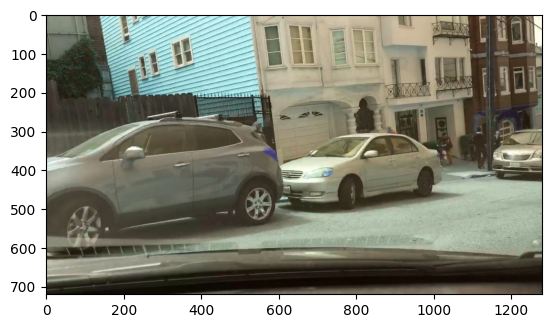

In [55]:
image1 = cv2.imread(train_location + img1['name'])
plt.imshow(image1)
image2 = cv2.imread(train_location + img2['name'])
plt.imshow(image2)

In [56]:
annot1 = img1['labels'][idx_1_2[0][0]]
roi_corners1 = np.array([annot1['poly2d'][0]['vertices']], dtype=np.int32)
roi_mean1 = np.mean(roi_corners1[0], axis=0)
roi_norm1 = roi_corners1[0] - roi_mean1
xmin1 = np.min(roi_corners1[0][:,0])
xmax1 = np.max(roi_corners1[0][:,0])
ymin1 = np.min(roi_corners1[0][:,1])
ymax1 = np.max(roi_corners1[0][:,1])

annot2 = img2['labels'][idx_1_2[0][1]]
roi_corners2 = np.array([annot2['poly2d'][0]['vertices']], dtype=np.int32)
roi_mean2 = np.mean(roi_corners2[0], axis=0)
roi_norm2 = roi_corners2[0] - roi_mean2
xmin2 = np.min(roi_corners2[0][:,0])
xmax2 = np.max(roi_corners2[0][:,0])
ymin2 = np.min(roi_corners2[0][:,1])
ymax2 = np.max(roi_corners2[0][:,1])

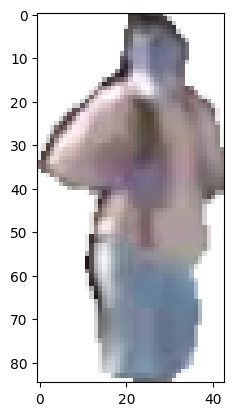

In [76]:
mask1 = np.ones(image1.shape, dtype=np.uint8)
# plt.imshow(mask1)
mask1.fill(255)
# plt.imshow(mask1)
cv2.fillPoly(mask1, roi_corners1, 0)
# plt.imshow(mask1)
masked_image1 = cv2.bitwise_or(image1, mask1)
# plt.imshow(masked_image1)
masking_obj1 = masked_image1[ymin1:ymax1, xmin1:xmax1]
# plt.imshow(masking_obj1)
masked_image1 = np.ones(image2.shape, dtype=np.uint8)
masked_image1.fill(255)
masking_obj1 = cv2.resize(masking_obj1, (xmax2-xmin2, ymax2-ymin2), interpolation = cv2.INTER_AREA)
# plt.imshow(masking_obj1)
masked_image1[ymin2:ymax2, xmin2:xmax2] = masking_obj1
img2_mask = np.vstack((((xmax2-xmin2)/float(xmax1-xmin1))*roi_norm1[:,0], ((ymax2-ymin2)/float(ymax1-ymin1))*roi_norm1[:,1])).T 


In [ ]:
    
    annot1 = i1['labels'][idx_1_2[swap_idx][0]]
    roi_corners1 = np.array([annot1['poly2d'][0]['vertices']], dtype=np.int32)
    roi_mean1 = np.mean(roi_corners1[0], axis=0)
    roi_norm1 = roi_corners1[0] - roi_mean1
    xmin1 = np.min(roi_corners1[0][:,0])
    xmax1 = np.max(roi_corners1[0][:,0])
    ymin1 = np.min(roi_corners1[0][:,1])
    ymax1 = np.max(roi_corners1[0][:,1])
    
    image2 = cv2.imread(train_location + i2['name'])
    annot2 = i2['labels'][idx_1_2[swap_idx][1]]
    roi_corners2 = np.array([annot2['poly2d'][0]['vertices']], dtype=np.int32)
    roi_mean2 = np.mean(roi_corners2[0], axis=0)
    roi_norm2 = roi_corners2[0] - roi_mean2
    xmin2 = np.min(roi_corners2[0][:,0])
    xmax2 = np.max(roi_corners2[0][:,0])
    ymin2 = np.min(roi_corners2[0][:,1])
    ymax2 = np.max(roi_corners2[0][:,1])
    
    mask1 = np.ones(image1.shape, dtype=np.uint8)
    mask1.fill(255)
    cv2.fillPoly(mask1, roi_corners1, 0)
    masked_image1 = cv2.bitwise_or(image1, mask1)
    masking_obj1 = masked_image1[ymin1:ymax1, xmin1:xmax1]
    masked_image1 = np.ones(image2.shape, dtype=np.uint8)
    masked_image1.fill(255)
    masking_obj1 = cv2.resize(masking_obj1, (xmax2-xmin2, ymax2-ymin2), interpolation = cv2.INTER_AREA)
    masked_image1[ymin2:ymax2, xmin2:xmax2] = masking_obj1
    img2_mask = np.vstack((((xmax2-xmin2)/float(xmax1-xmin1))*roi_norm1[:,0], ((ymax2-ymin2)/float(ymax1-ymin1))*roi_norm1[:,1])).T    
    mask2 = np.ones(image2.shape, dtype=np.uint8)
    mask2.fill(255)
    cv2.fillPoly(mask2, np.array([img2_mask+roi_mean2], dtype=np.int), 0)
    mask2 = 255 - mask2
    mask2 = cv2.blur(mask2,(10,10))
    masked_image2 = cv2.bitwise_or(image2, mask2)
    swapped_1 = cv2.bitwise_and(masked_image1, masked_image2)
    
    mask2 = np.ones(image2.shape, dtype=np.uint8)
    mask2.fill(255)
    cv2.fillPoly(mask2, roi_corners2, 0)
    masked_image2 = cv2.bitwise_or(image2, mask2)
    masking_obj2 = masked_image2[ymin2:ymax2, xmin2:xmax2]
    masked_image2 = np.ones(image1.shape, dtype=np.uint8)
    masked_image2.fill(255)
    masking_obj2 = cv2.resize(masking_obj2, (xmax1-xmin1, ymax1-ymin1), interpolation = cv2.INTER_AREA)
    masked_image2[ymin1:ymax1, xmin1:xmax1] = masking_obj2
    img1_mask = np.vstack((((xmax1-xmin1)/float(xmax2-xmin2))*roi_norm2[:,0], ((ymax1-ymin1)/float(ymax2-ymin2))*roi_norm2[:,1])).T
    mask1 = np.ones(image1.shape, dtype=np.uint8)
    mask1.fill(255)
    cv2.fillPoly(mask1, np.array([img1_mask+roi_mean1], dtype=np.int), 0)
    mask1 = 255 - mask1
    mask1 = cv2.blur(mask1,(10,10))
    masked_image1 = cv2.bitwise_or(image1, mask1)
    swapped_2 = cv2.bitwise_and(masked_image2, masked_image1)
    